## Fine tuned model 


In [ ]:
! pip install peft accelerate transformers diffusers 


In [ ]:
! pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121


In [1]:
import torch
print("Torch version:", torch.__version__)
print("CUDA available:", torch.cuda.is_available())
print("CUDA version:", torch.version.cuda)
print("GPU:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU detected")


Torch version: 2.5.1+cu121
CUDA available: True
CUDA version: 12.1
GPU: NVIDIA GeForce RTX 4060 Laptop GPU


In [2]:
!nvidia-smi  

Sun Apr 20 16:38:04 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 571.96                 Driver Version: 571.96         CUDA Version: 12.8     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4060 ...  WDDM  |   00000000:01:00.0 Off |                  N/A |
| N/A   45C    P0             18W /  110W |       0MiB /   8188MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [1]:
from diffusers import StableDiffusionXLPipeline
from diffusers import DiffusionPipeline
import torch

C:\Users\prite\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from diffusers import DiffusionPipeline
import torch

# pipe = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16)
pipe = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16
)
pipe.to("cuda")

pipe.load_lora_weights("DGM_project/Kream-model-lora-finetune", weight_name="pytorch_lora_weights.safetensors")

C:\Users\prite\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Loading pipeline components...: 100%|██████████| 7/7 [00:09<00:00,  1.32s/it]
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModelWithProjection found with the prefix='text_encoder_2'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModelWithProjection related params. You can also try sp

In [5]:
from diffusers import StableDiffusionInpaintPipeline
import torch

in_pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "stabilityai/stable-diffusion-2-inpainting",
    torch_dtype=torch.float16
).to("cuda")


Loading pipeline components...: 100%|██████████| 6/6 [00:01<00:00,  3.26it/s]


100%|██████████| 10/10 [00:24<00:00,  2.42s/it]


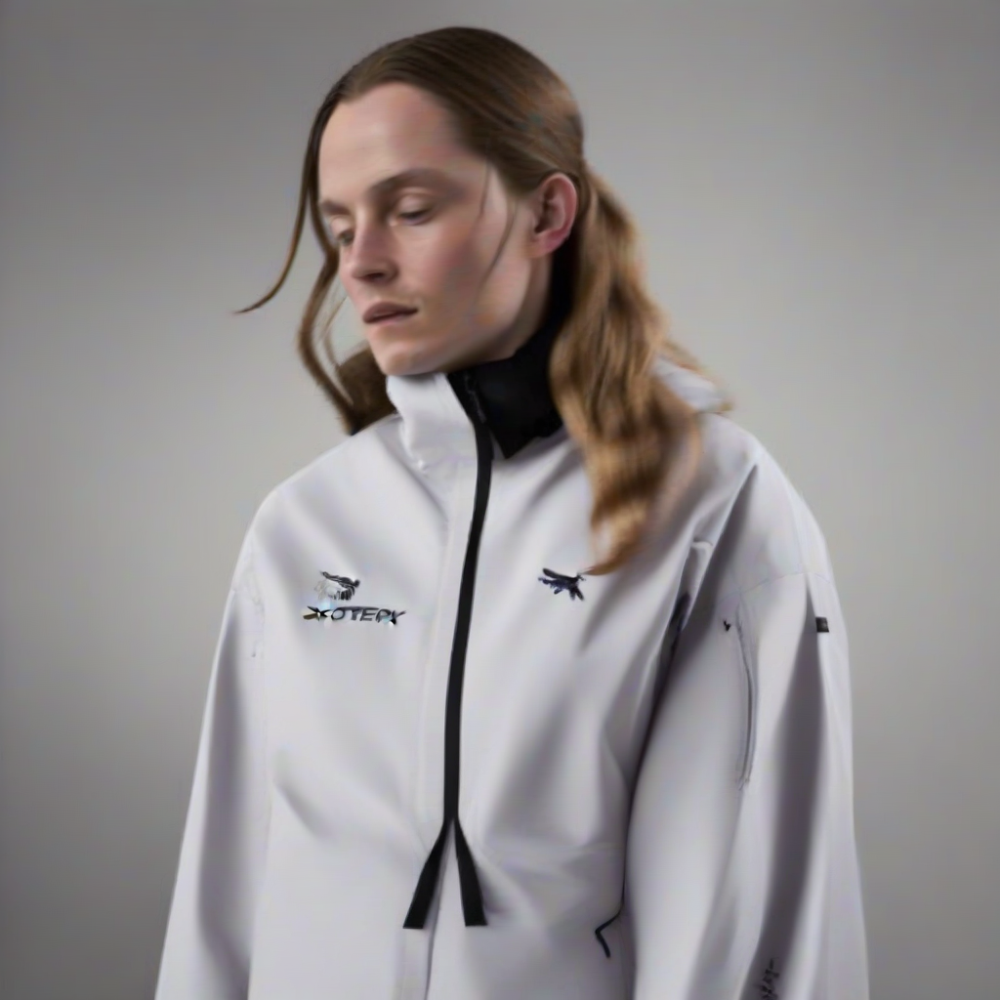

In [5]:
prompt = "A fashion-forward portrait of a model in a Arc'teryx Beta LT Jacket Black, dramatic lighting, minimalist backdrop, \
     logo highlighted, sharp details, high-quality 4k photo, modern and stylish appearance, well-defined face, confident expression, with a clean, polished look."

pipe(prompt, num_inference_steps=10, guidance_scale=8.5).images[0]


100%|██████████| 50/50 [00:30<00:00,  1.62it/s]


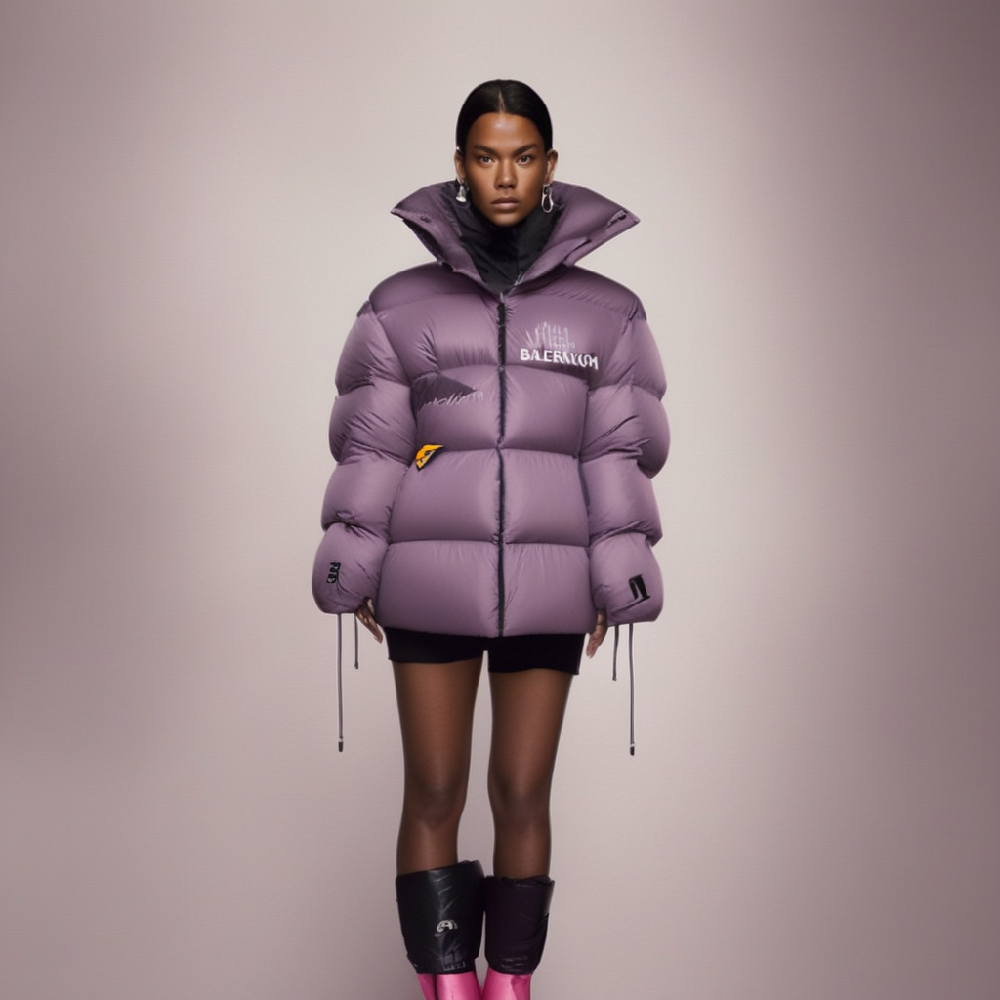

In [2]:

prompt = "A fashion-forward portrait of a model in a Nike x Balenciaga puffer jacket, dramatic lighting, minimalist backdrop, \
     logo highlighted, sharp details, high-quality 4k photo, modern and stylish appearance, well-defined face, confident expression, with a clean, polished look."

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic  logos. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."

image = pipe(prompt=prompt, negative_prompt=negative_prompt).images[0]

image

100%|██████████| 50/50 [00:30<00:00,  1.62it/s]


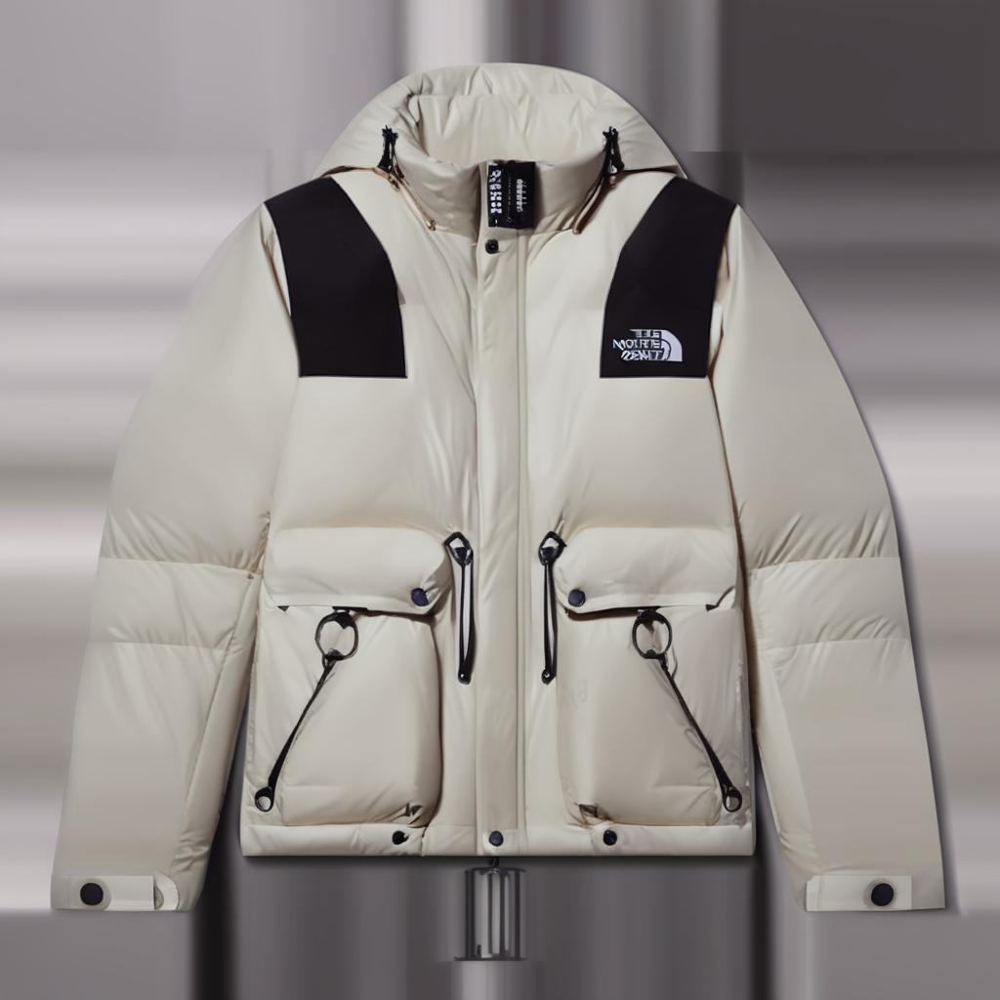

In [ ]:

prompt = "A fashion-forward portrait of a men model in a Noth face jacket,with clear logo on the chest writen north face correctly, dramatic lighting, minimalist backdrop, \
     logo highlighted, sharp details, high-quality 4k photo, modern and stylish appearance, well-defined face, confident expression, with a clean, polished look."

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen North Face logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic  logos. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."

image = pipe(prompt=prompt, negative_prompt=negative_prompt,num_inference_steps=50, guidance_scale=8.5).images[0]

image

100%|██████████| 50/50 [00:30<00:00,  1.62it/s]


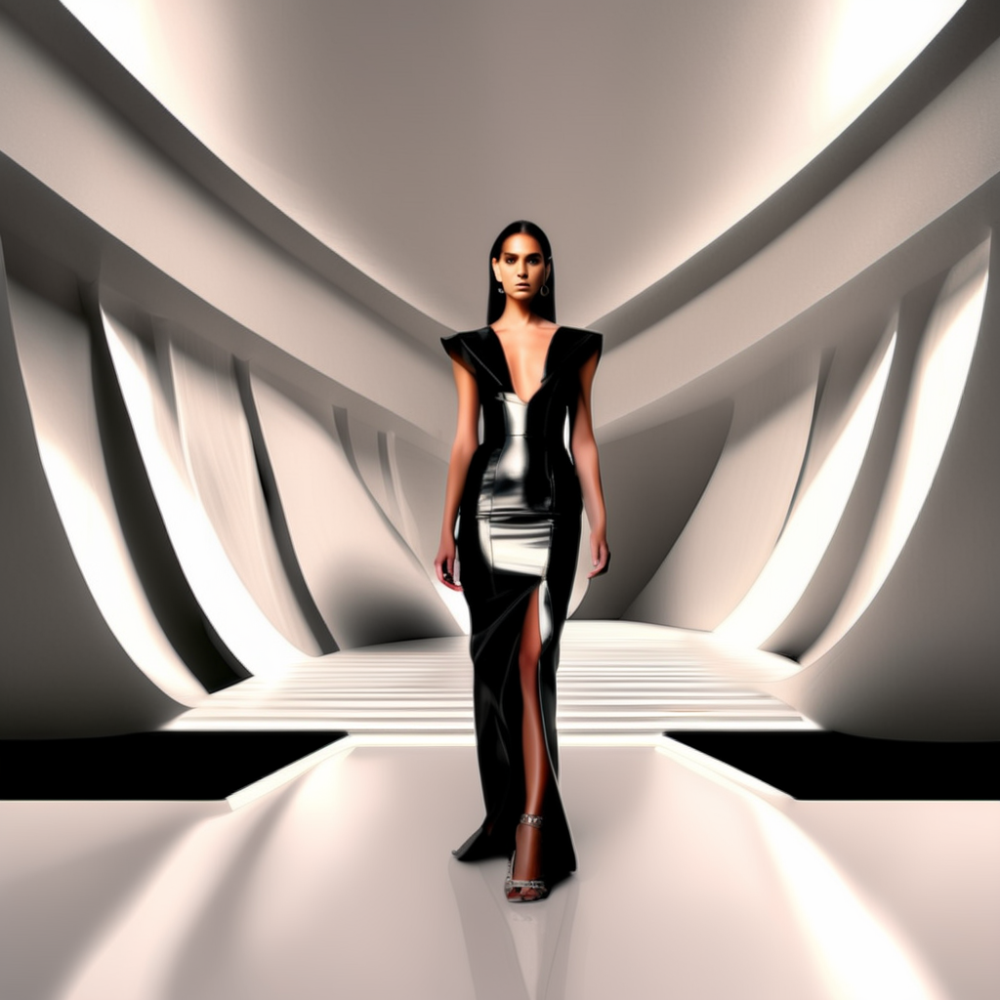

In [17]:

prompt = "ull body, woman walking down runway in avant-garde couture gown, dramatic lighting and shadows, elevated pose, high-fashion runway look, spotlight background, dramatic lighting, minimalist backdrop, \
     logo highlighted, sharp details, high-quality 4k photo, modern and stylish appearance, well-defined face, confident expression, with a clean, polished look."

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic  logos. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."

image = pipe(prompt=prompt, negative_prompt=negative_prompt,num_inference_steps=50, guidance_scale=8.5).images[0]

image

Token indices sequence length is longer than the specified maximum sequence length for this model (94 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['appearance, well - defined face, confident expression, with a clean, polished look.']
Token indices sequence length is longer than the specified maximum sequence length for this model (94 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['appearance, well - defined face, confident expression, with a clean, polished look.']
100%|██████████| 50/50 [00:30<00:00,  1.62it/s]


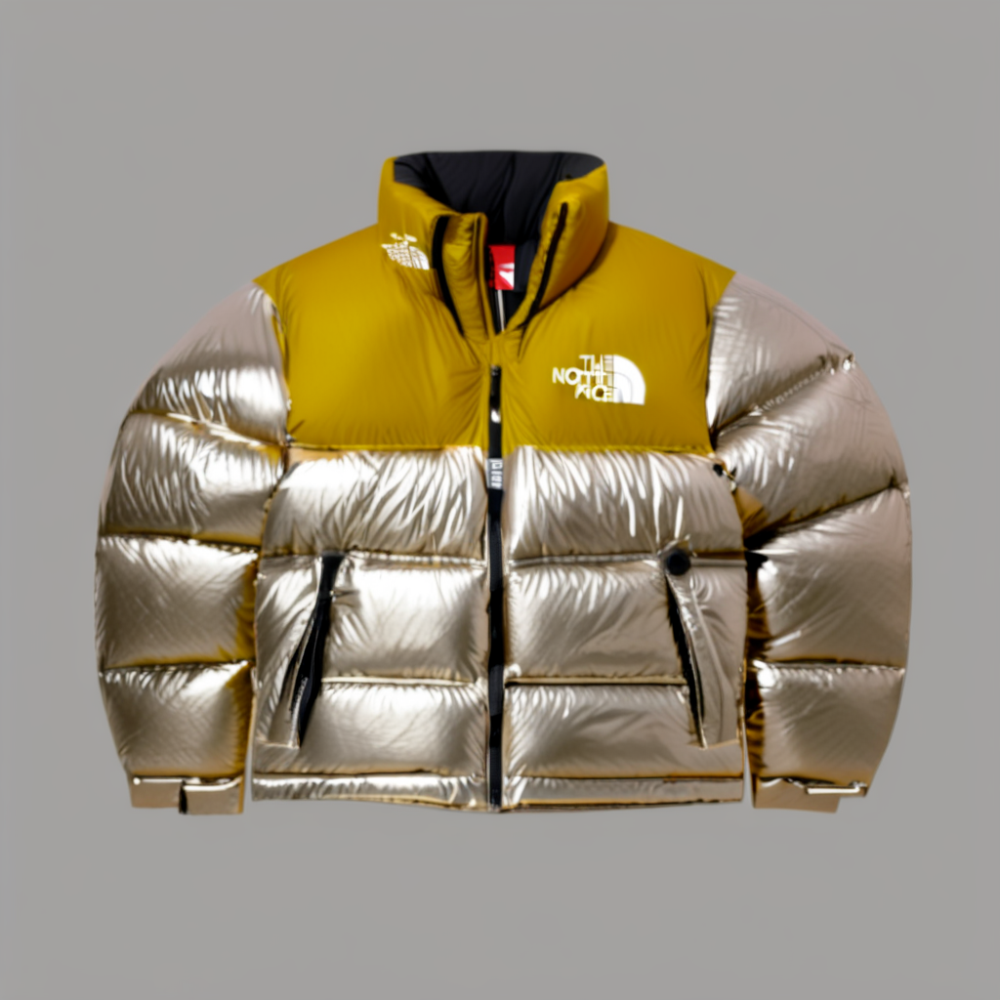

In [18]:

prompt = "outer, The North Face 1996 Retro Nuptse Jacket Summit Gold, a photography of a yellow puffer jacket with a logo on the front and visible down fill."

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic  logos. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."

image = pipe(prompt=prompt, negative_prompt=negative_prompt,num_inference_steps=50, guidance_scale=8.5).images[0]

image

100%|██████████| 50/50 [00:30<00:00,  1.63it/s]


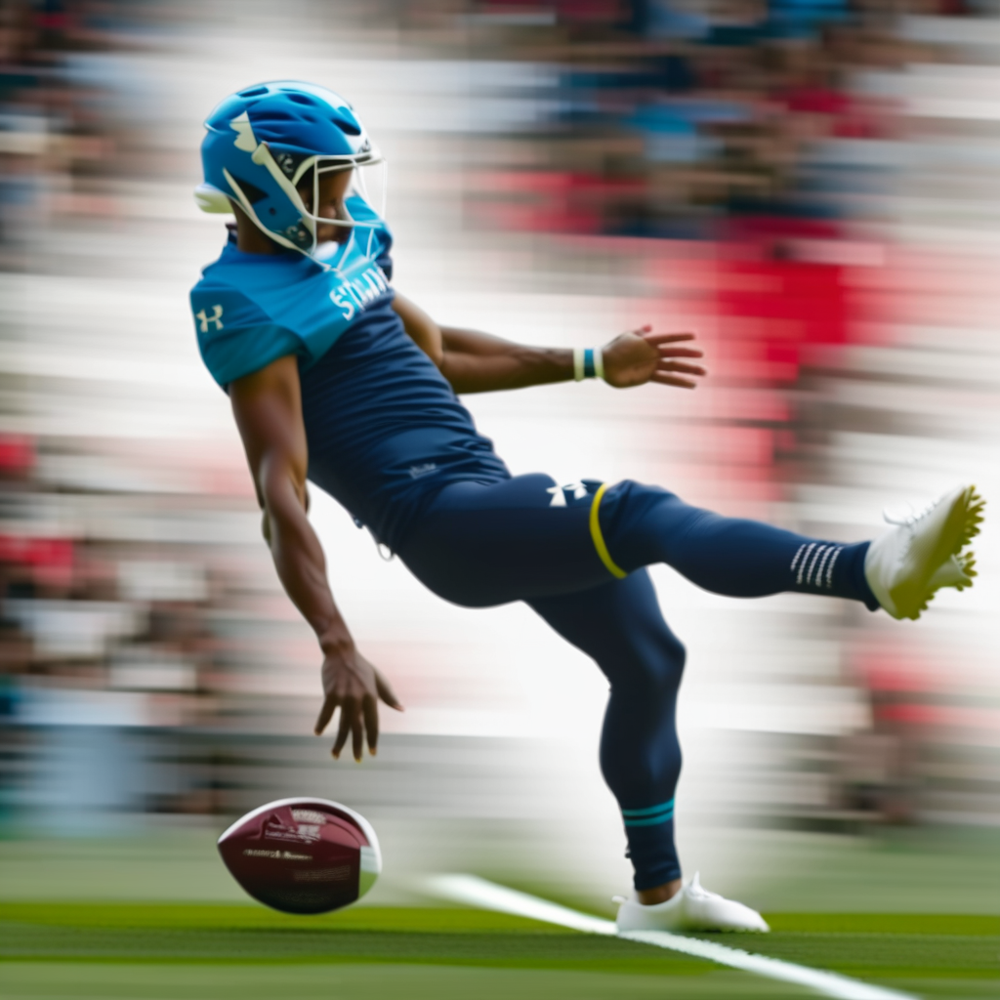

In [32]:
prompt = "A football player in mid-action kicking a ball, wearing branded athletic gear from Under Armour, dynamic composition, motion blur effect"

negative_prompt = "blurry, deformed, extra limbs, fused fingers, cropped head, distorted face, bad anatomy, low resolution, watermark, text, logo artifacts, duplicated person, glitch, low quality, grainy, unnatural poses, poorly drawn hands, out of frame"

image = pipe(prompt=prompt, negative_prompt=negative_prompt,num_inference_steps=50, guidance_scale=8.5).images[0]

image

100%|██████████| 50/50 [00:30<00:00,  1.62it/s]


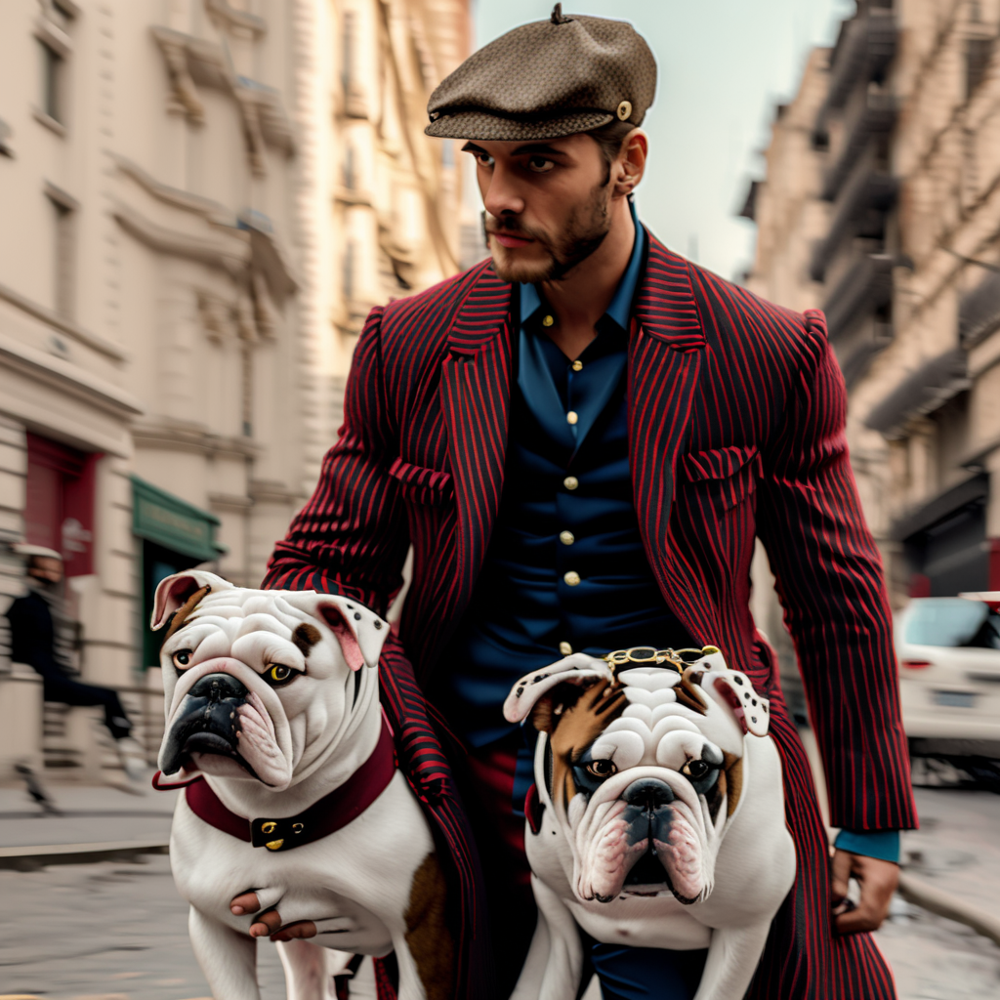

In [30]:
prompt = "A fashion-forward man walking a bulldog in city streets, both dressed in coordinating luxury outfits, urban vibes, magazine editorial style , sharp details, high-quality 4k photo with good lighting oh human face "

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic  logos. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."

image = pipe(prompt=prompt, negative_prompt=negative_prompt,num_inference_steps=50, guidance_scale=8.5).images[0]

image

100%|██████████| 50/50 [00:30<00:00,  1.62it/s]


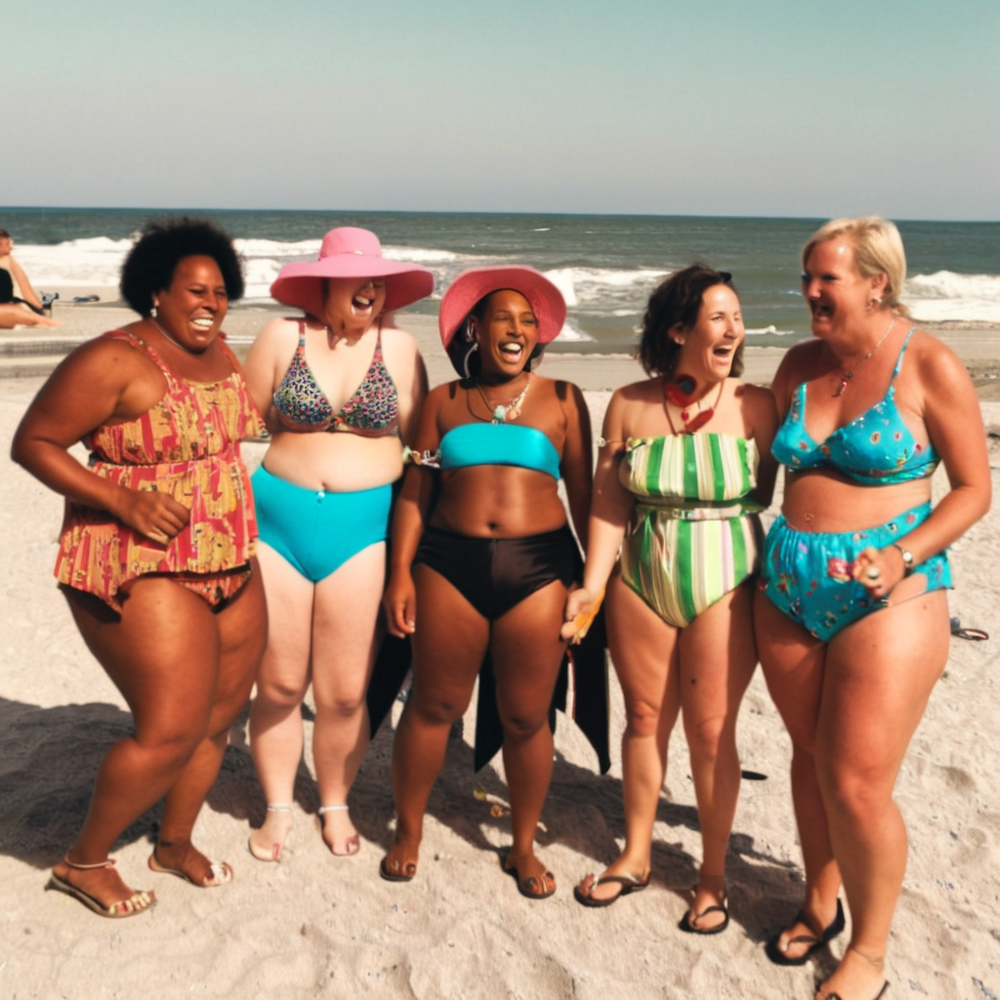

In [ ]:
prompt = "A diverse group of friends at a beach, each wearing different branded swimsuits and accessories, laughing, candid shot, vibrant summer colors , sharp details, high-quality 4k photo"

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic  logos. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."

image = pipe(prompt=prompt, negative_prompt=negative_prompt,num_inference_steps=50, guidance_scale=8.5).images[0]

image


100%|██████████| 50/50 [00:30<00:00,  1.63it/s]


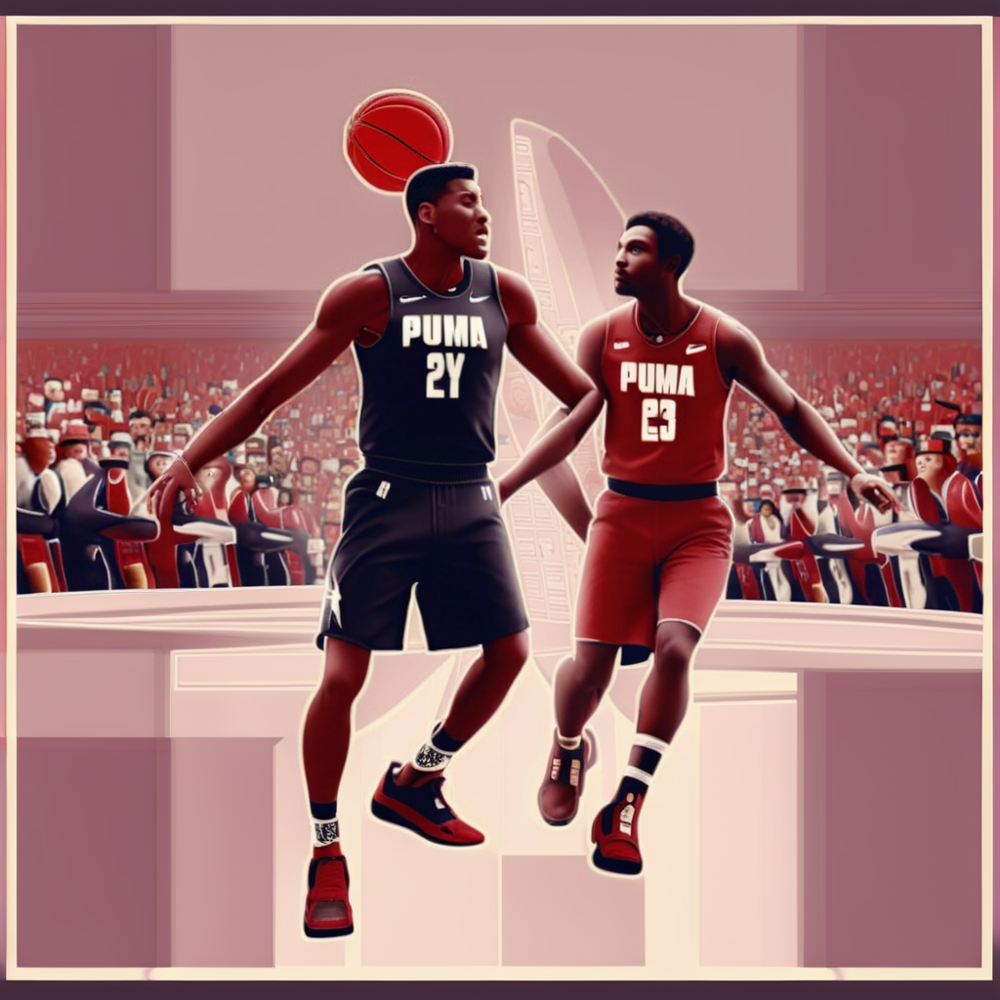

In [24]:
prompt = "Two basketball players mid-game in branded jerseys (Nike, Puma), action-packed court scene with audience in background, stadium lights and intensity"

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic  logos. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."

image = pipe(prompt=prompt, negative_prompt=negative_prompt,num_inference_steps=50, guidance_scale=8.5).images[0]

image


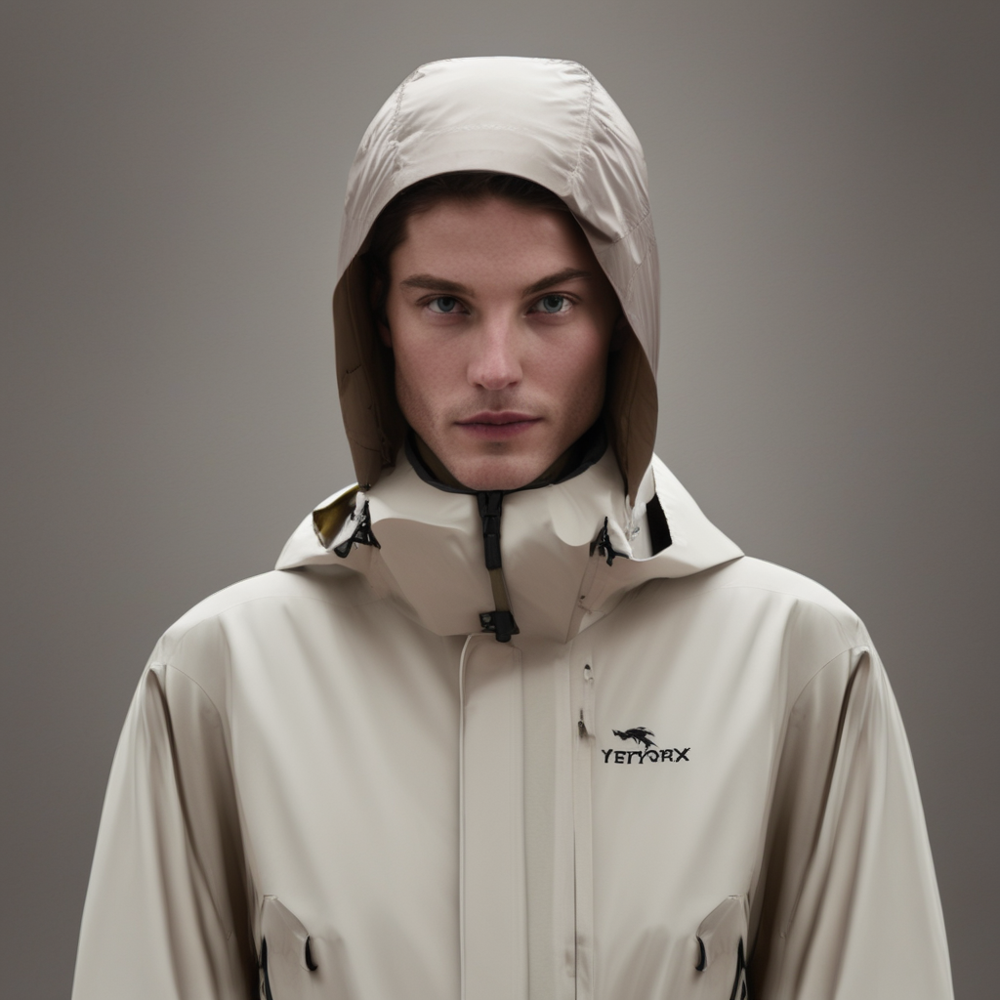

In [ ]:
prompt = "A fashion-forward portrait of a model in a Arc'teryx Beta LT Black Jacket, dramatic lighting, minimalist backdrop, \
     logo highlighted, sharp details, high-quality 4k photo, modern and stylish appearance, well-defined face, confident expression, with a clean, polished look."

negative_prompt = "Avoid poorly rendered or distorted logos, blurry or incomplete logos, \
unnatural logo placements, unrecognizable or misshapen logos, off-center logos, non-branded logos, logos with mismatched colors or shapes, \
unrealistic Arc'teryx logos, logos not in line with Arc'teryx design standards. Avoid distorted or exaggerated facial features, unrealistic skin textures, \
poor lighting on the face, blurry or pixelated faces, faces with strange expressions, poorly aligned facial features, or faces with unprofessional styling. \
Exclude facial artifacts such as asymmetry, low resolution, or unrecognizable features."
image = pipe(prompt=prompt, negative_prompt=negative_prompt).images[0]

image

100%|██████████| 65/65 [00:40<00:00,  1.62it/s]


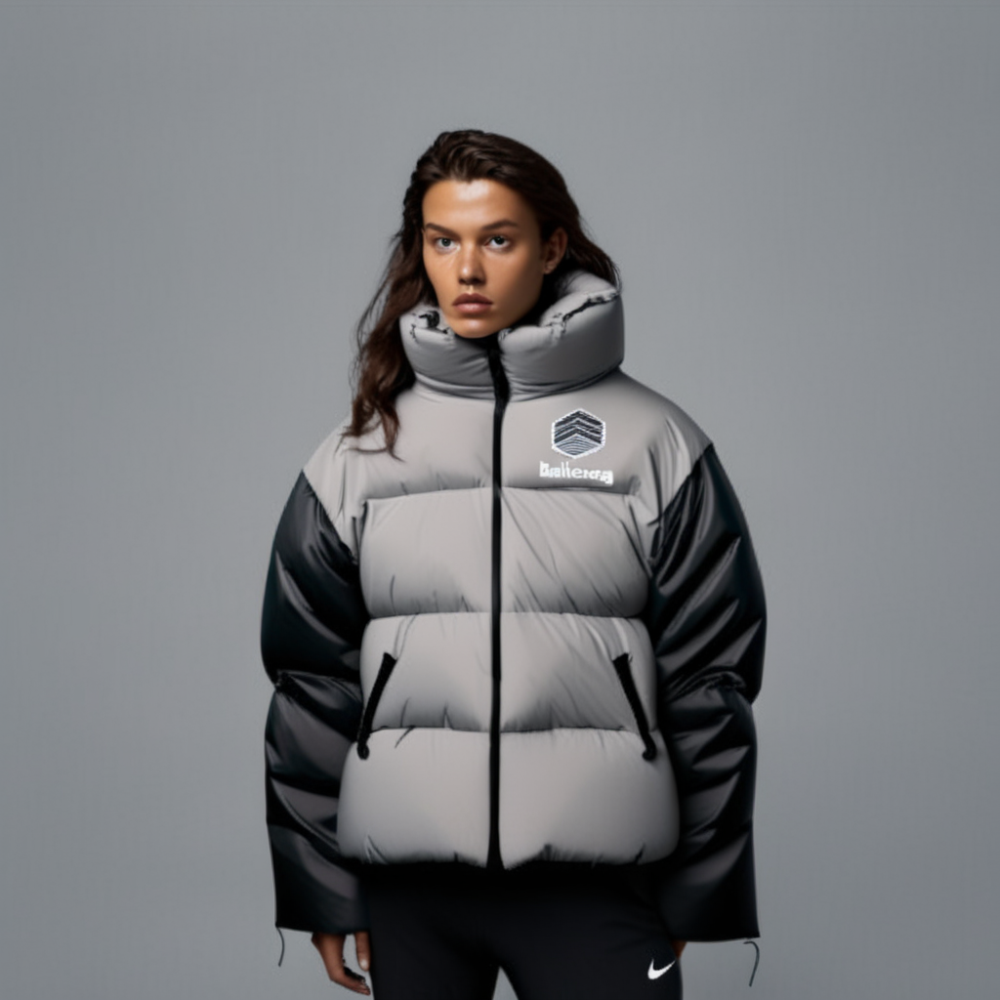

In [10]:
prompt = "A fashion-forward portrait of a model in a black Nike x Balenciaga puffer jacket, dramatic lighting, minimalist backdrop, logo highlighted, 4k photo"

pipe(prompt, num_inference_steps=65, guidance_scale=8.5).images[0]


100%|██████████| 60/60 [00:37<00:00,  1.62it/s]


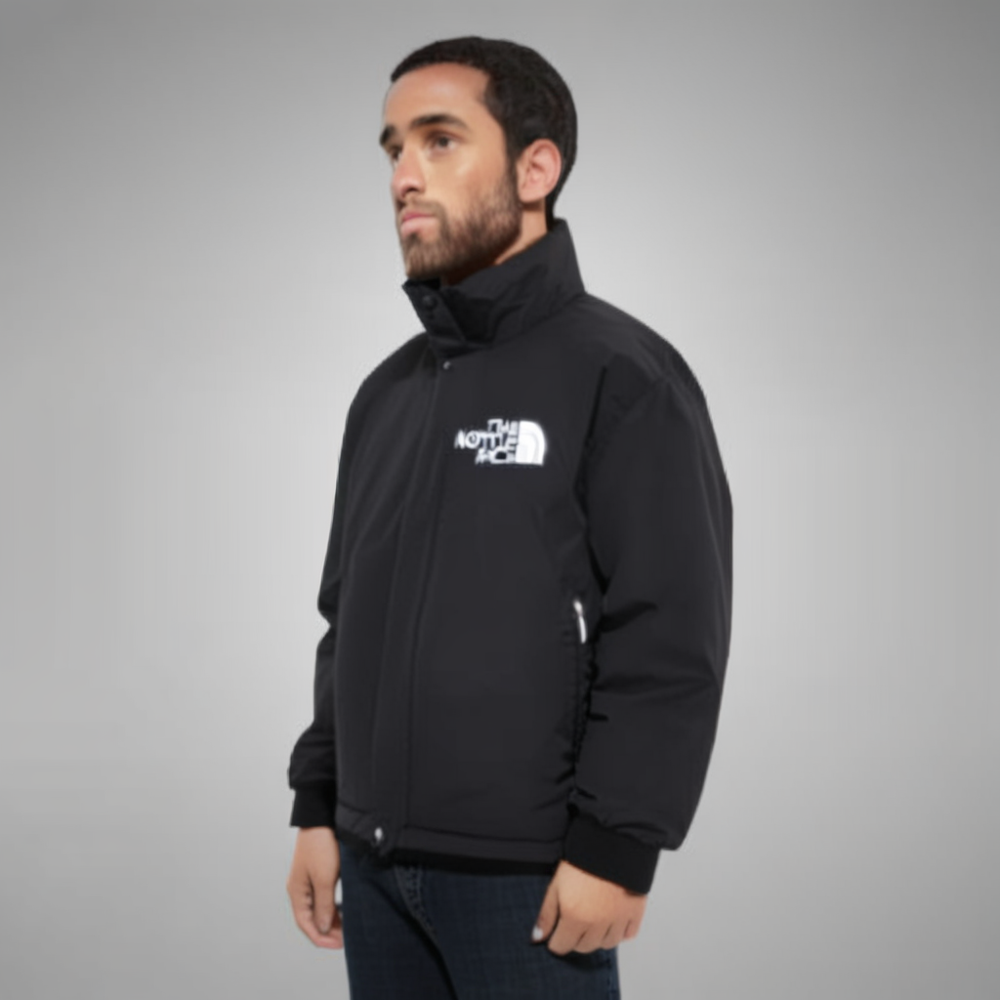

In [2]:
prompt = "A Person wearing a black north face jacket -  with a clear logo on the chest with clear backgroud and the person is like fashion model and standing in stylish way"

pipe(prompt, num_inference_steps=60, guidance_scale=10).images[0]

100%|██████████| 50/50 [00:30<00:00,  1.63it/s]


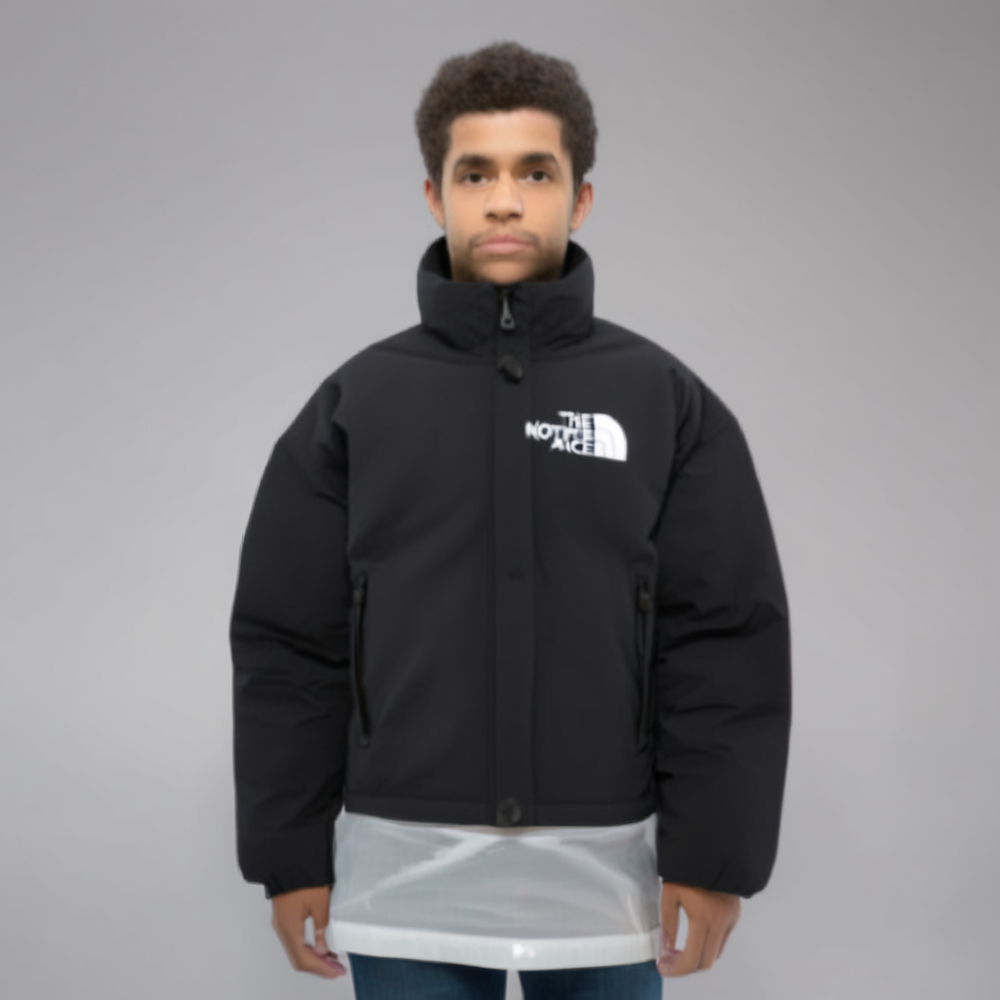

In [ ]:
prompt = "A Person wearing a black north face jacket -  with a logo on the chest with clear backgroud and the person is like fashion model and standing in stylish way"

pipe(prompt, num_inference_steps=50, guidance_scale=8.5).images[0]

100%|██████████| 50/50 [00:30<00:00,  1.62it/s]


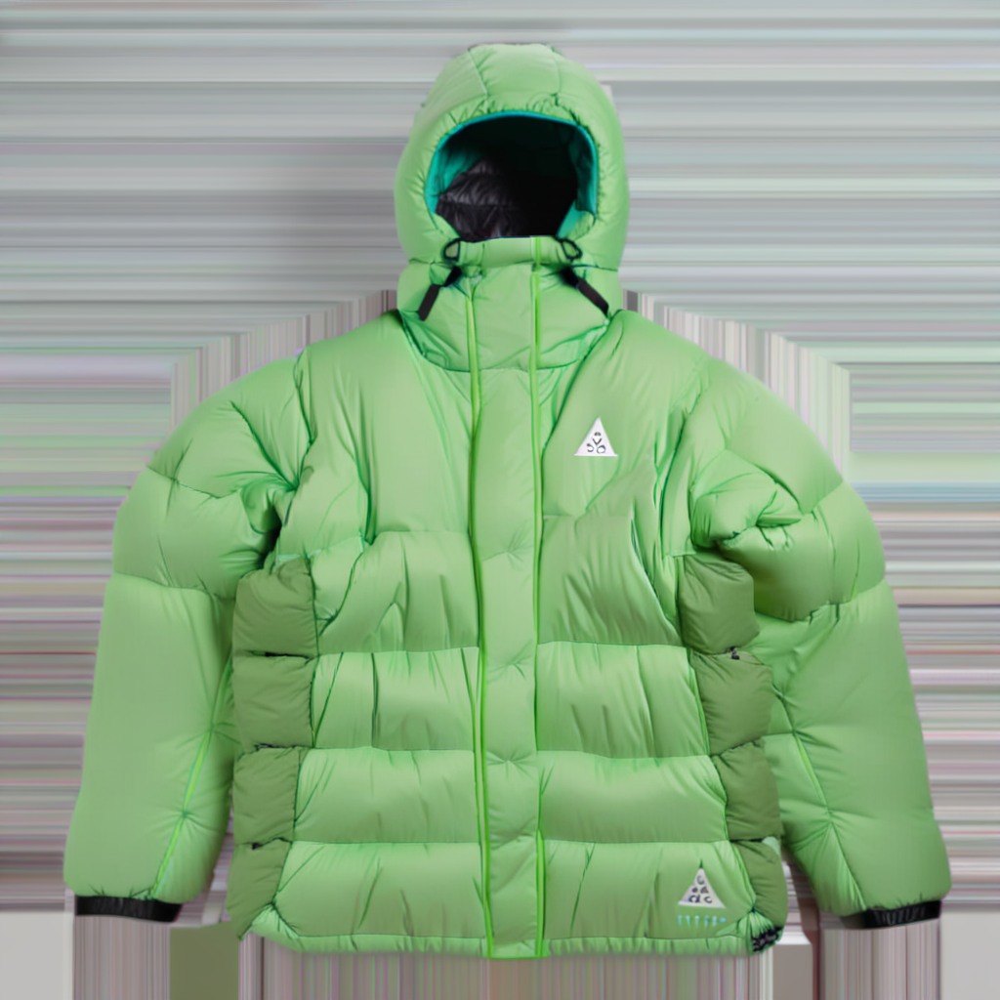

In [6]:
prompt = "outer, Nike ACG Therma-Fit ADV Lunar Lake Puffer Jacket Safety Orange - Asia, a photography of an orange jacket with a hood"
pipe(prompt, num_inference_steps=50, guidance_scale=9.5).images[0]

100%|██████████| 50/50 [00:35<00:00,  1.40it/s]


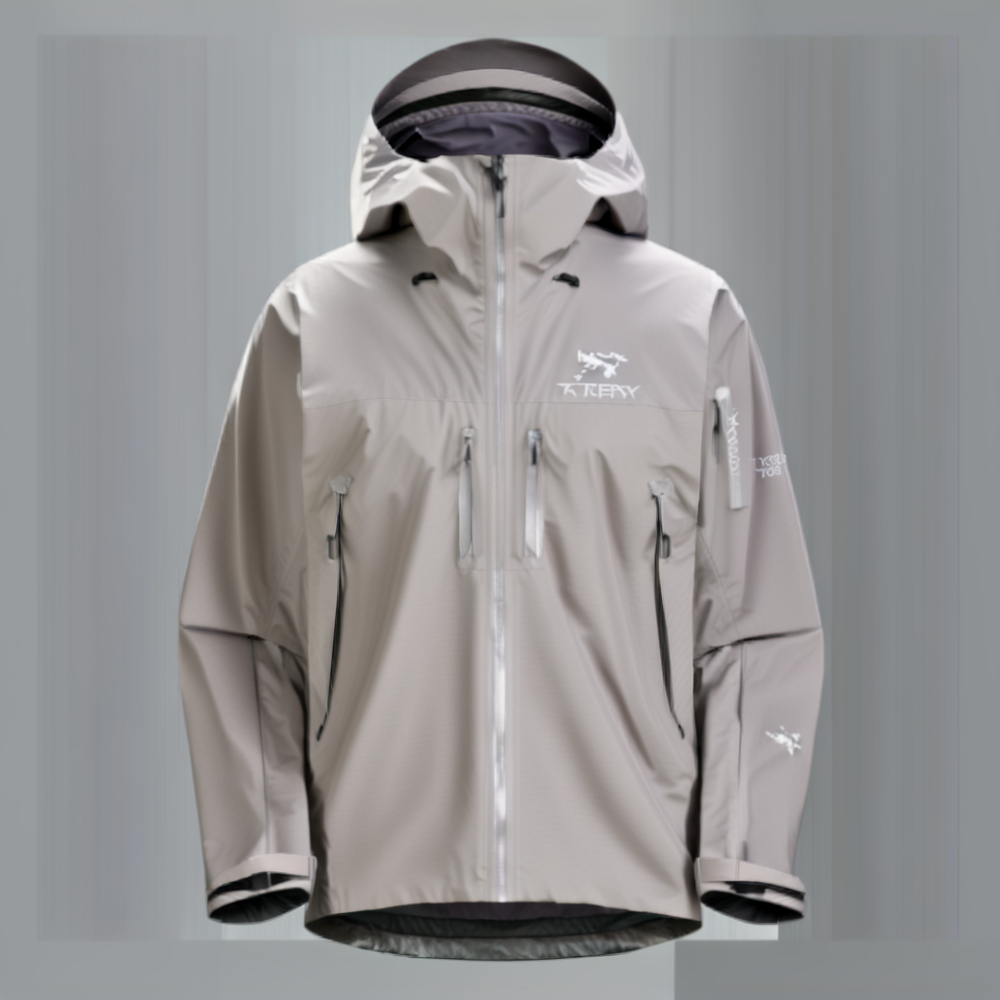

In [ ]:
prompt = "outer, Arc'teryx Beta LT Jacket Black, a photography of a black jacket with a hood on"
pipe(prompt, num_inference_steps=50, guidance_scale=9.5).images[0]

100%|██████████| 30/30 [00:18<00:00,  1.64it/s]


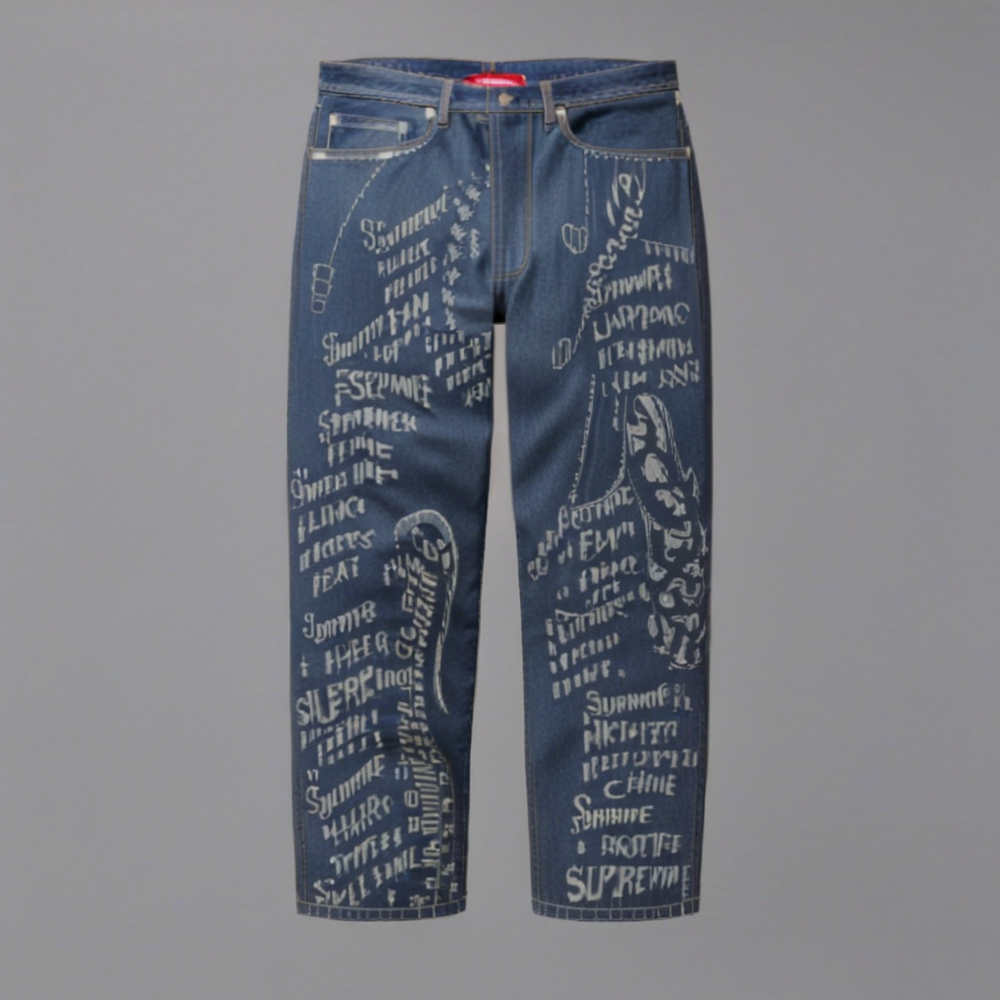

In [ ]:
prompt = "bottom, Supreme Animal Print Baggy Jean Washed Indigo - 23FW, a photography of a dark blue jean with an animal printing on"
#pipe(prompt, num_inference_steps=30, guidance_scale=10.5).images[0]
pipe(prompt, num_inference_steps=30, guidance_scale=7.5).images[0]